In [ ]:
!pip install pinecone-client datasets torch

In [1]:
import pinecone

pinecone.init(
    api_key="<<YOUR_API_KEY>>",
    environment="us-west1-gcp"
)
index = pinecone.Index("imagenet-query-trainer-clip")

In [2]:
from datasets import load_dataset

imagenet = load_dataset(
    'frgfm/imagenette',
    'full_size',
    split='train',
    ignore_verifications=False  # set to True if seeing splits Error
)

Reusing dataset imagenette (/Users/jamesbriggs/.cache/huggingface/datasets/frgfm___imagenette/full_size/1.0.0/a20d055d57be042afce122292de9b20ab726b38ce7b081fb5e8d8b82846412ee)


We will start with an unrelated embedding so that we can initialize our model weights to be within a similar vector space to the embeddings themselves (rather than being completely random).

This is optional, you can start with random weights if preferred, but ofcourse you will not return the same results in the same order as we do here.

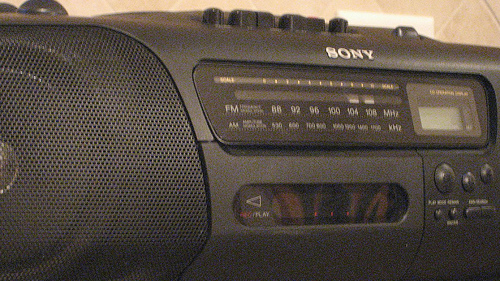

In [3]:
# we'll start with the embedding of this radio
imagenet[0]['image']

We retrieve it from Pinecone like so:

In [4]:
xc = index.fetch(ids=['0'])

And extract the embedding.

In [5]:
init_weight = xc['vectors']['0']['values']

We will use a linear classifier model to learn the "perfect query" based on our selections. For this we will use a linear layer from PyTorch, find [install instructions for PyTorch here](https://pytorch.org), or just do following (not recommended):

```
!pip install torch
```

In [6]:
import torch

# initialize the model with 768 input size and one output
model = torch.nn.Linear(768, 1)

# ---------------------------------------------------------------
# OPTIONAL: so that you can replicate the exact process we run through here,
#           you need to begin with the same model weights, we do that like
#           so:
# convert previous radio image to tensor paramater for model weights
init_weight = torch.Tensor(init_weight).reshape(1, -1)
model.weight = torch.nn.Parameter(init_weight)
# ---------------------------------------------------------------

# init loss and optimizer
loss = torch.nn.BCEWithLogitsLoss()
optimizer = torch.optim.SGD(model.parameters(), lr=0.1)

# set the query vector `xq` as the first state of the model
xq = model.weight.detach().numpy()[0].tolist()

Alternatively, rather than extracting the randomly initialized model weights as our first query, *if* we already have a query, we can do the opposite and set the initial model weights to our query vector `xq` as we did with the Numpy weights above:

```python
# set the first state of the model using an existing embedding `xq`
init_weight = torch.Tensor(xq).reshape(1, -1)
model.weight = torch.nn.Parameter(init_weight)
```

In either scenario, we move on to our first query. We retrieve `10` of the most similar records and store them in `xc`:

In [7]:
xc = index.query(xq, top_k=10, include_values=True)

`xc` contains more than just the vectors, it is a JSON object in the format:

```json
{'matches': [
    {
        'id': '<<ID of retrieved item #1>>',
        'score': 0.53,  # float value similarity score
        'values': [-0.22, 0.21, ...],  # the vector embedding itself
    },
    {
        'id': '<<ID of retrieved item #2>>',
        'score': 0.41,
        'values': [-0.19, 0.29, ...],
    },
    ...  # this continues for the 10 records we've returned
],
'namespace': ''}
```

We don't need all of this information, all we need are the ID values that we will convert to index values for extracting and displaying the images themselves, and the vectors for training the model.

In [8]:
# get the index values
idx = [int(match['id']) for match in xc['matches']]
idx

[0, 64, 768, 448, 320, 896, 704, 576, 256, 512]

In [9]:
# get the vectors
values = [match['values'] for match in xc['matches']]

# OPTIONAL:
# store the query and returned embeddings in a list for later visuals
xq_list = [xq]
xc_list = [list(zip(idx, values))]

Now we can see what these returned images look like.

0


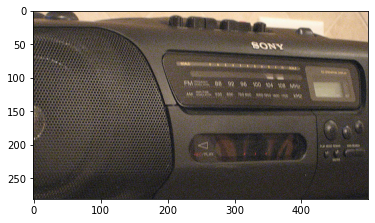

64


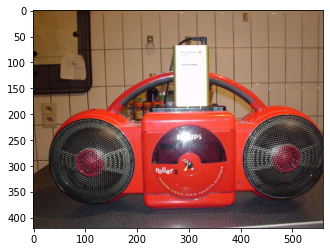

768


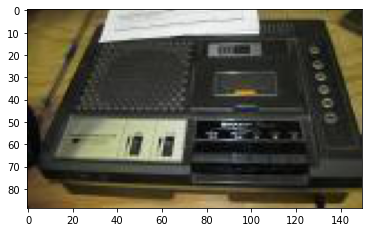

448


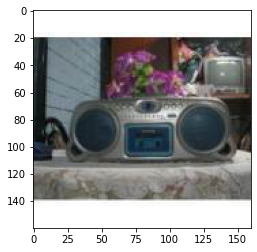

320


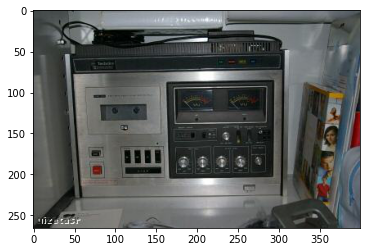

896


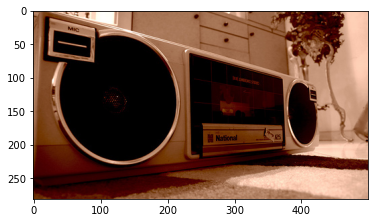

704


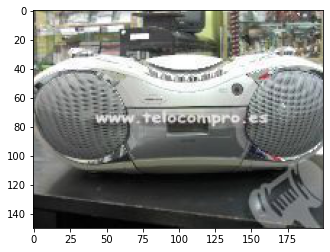

576


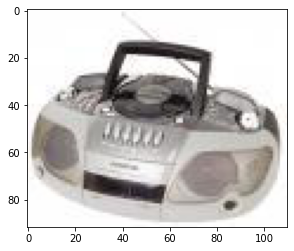

256


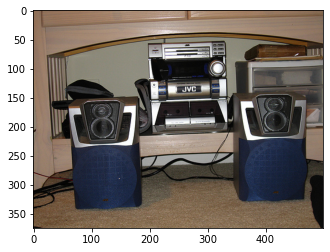

512


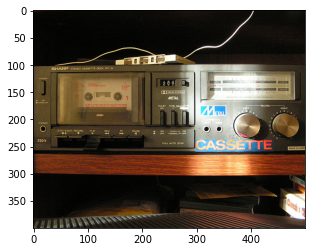

In [10]:
import matplotlib.pyplot as plt

for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

Let's see if we can push the model to generate vectors that return dogs, right now we can't see any dogs so we have to set all of these images as negatives (eg class label `0`).

In [11]:
positives = []
negatives = idx

Now we use these vectors extracted from Pinecone to train our linear classifier.

In [12]:
positives = [
    match['values'] for match in xc['matches'] if int(match['id']) in positives
]
negatives = [
    match['values'] for match in xc['matches'] if int(match['id']) in negatives
]

In [13]:
y = [1] * len(positives) + [0] * len(negatives)
y  # these are our target labels

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0]

In [14]:
X = positives + negatives
len(X)  # and these the training inputs

10

Now we have our first training batch ready, we can perform a training loop with our classifier, which we will define in a function called `fit`:

In [15]:
from tqdm.auto import tqdm

model.train()

def fit(X: list, y: list, iters: int = 30):
    with tqdm(total=iters) as pbar:
        for _ in range(iters):
            # get predictions
            out = model(torch.Tensor(X))
            # calculate loss
            loss_value = loss(out, torch.Tensor(y).reshape(-1, 1))
            # reset gradients
            optimizer.zero_grad()
            # backpropagate
            loss_value.backward()
            # update weights
            optimizer.step()
            pbar.update(1)
            pbar.set_postfix(loss=loss_value.item())

In [16]:
# train
fit(X, y)

  0%|          | 0/30 [00:00<?, ?it/s]

Now we extract a new query vector from the model weights:

In [17]:
model.weight.shape

torch.Size([1, 768])

We need to convert this to a flat list for Pinecone:

In [18]:
xq = model.weight.detach().numpy()[0].tolist()

Now before we search again we must mark the already retrieved vectors so that we can filter them out of future queries. We do this using metadata filtering in Pinecone.

In [19]:
# we must update one record at a time
for i in idx:
    index.update(str(i), set_metadata={"seen": 1})

Now search using the new query vector.

222


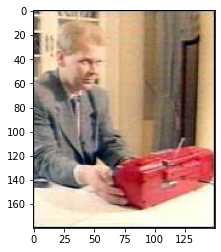

464


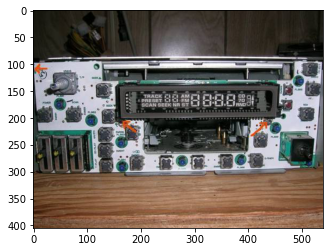

7217


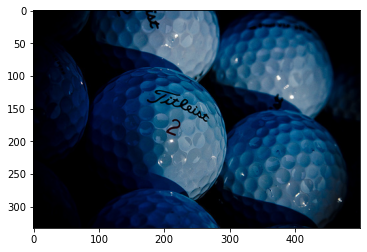

7303


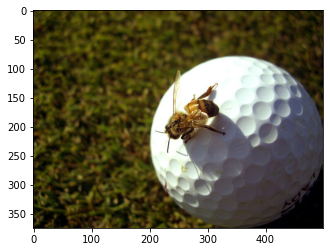

4609


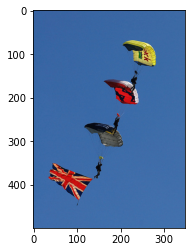

226


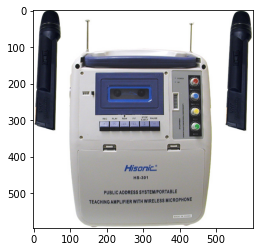

161


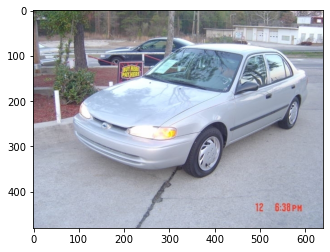

219


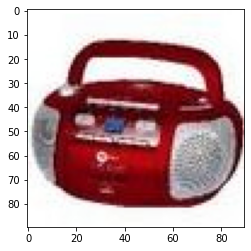

4615


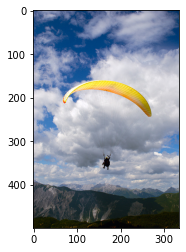

809


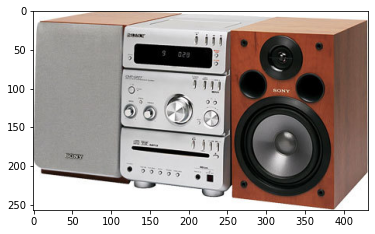

In [20]:
# retrieve most similar records
xc = index.query(
    xq,
    top_k=10,
    include_values=True,
    filter={"seen": 0}
)
# extract index and vector values
idx = [int(match['id']) for match in xc['matches']]
values = [match['values'] for match in xc['matches']]

# visualize the results
for i in idx:
    print(i)
    plt.imshow(imagenet[i]['image'])
    plt.show()

# OPTIONAL:
# store the query and results in a list for later visuals
xq_list.append(xq)
xc_list.append(list(zip(idx, values)))

As we're going from a completely random starting point, we will need to bounce around different sets of images before "randomly" running in to any dog images. So let's clean up our code a little starting with the tuning operation. All we'll do here is place all of the previous logic into a function called `tune`:

In [21]:
def tune(positives, xc, idx, update=True):
    # confirm any positives actually exist
    for i in positives:
        assert i in idx
    # extract positive and negative vectors
    negatives = [i for i in idx if i not in positives]
    positives = [
        match['values'] for match in xc['matches'] if int(match['id']) in positives
    ]
    negatives = [
        match['values'] for match in xc['matches'] if int(match['id']) in negatives
    ]
    # create target labels
    y = [1] * len(positives) + [0] * len(negatives)
    # create training inputs
    X = positives + negatives
    # train
    fit(X, y)
    # extract new query vector
    xq = model.weight.detach().numpy()[0].tolist()
    # OPTIONAL: append query vector to list for later visualization
    xq_list.append(xq)
    # and update the "seen" metadata
    if update:
        # we must update one record at a time
        for i in idx:
            index.update(str(i), set_metadata={"seen": 1})
    return xq

Now we update the model and query:

In [22]:
positives = []  # again, no positives here
xq = tune(positives, xc, idx)

  0%|          | 0/30 [00:00<?, ?it/s]

Now we return to retrieving more images. Again, let's collate all of the logic from before into a single `get_top_k` function:

In [23]:
def get_top_k(xq, top_k=10):
    xc = index.query(
        xq,
        top_k=top_k,
        include_values=True,
        filter={"seen": 0}
    )
    idx = [int(match['id']) for match in xc['matches']]
    values = [match['values'] for match in xc['matches']]
    # OPTIONAL: append retrieved vectors to list for later visualization
    xc_list.append(list(zip(idx, values)))
    for i in idx:
        print(i)
        plt.imshow(imagenet[i]['image'])
        plt.show()
    return idx, xc

Now we retrieve those records:

8320


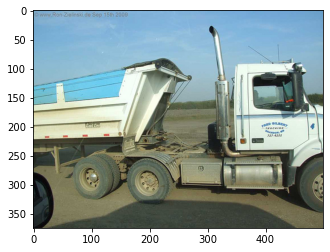

7680


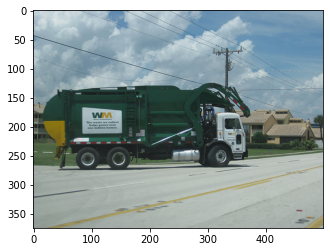

8000


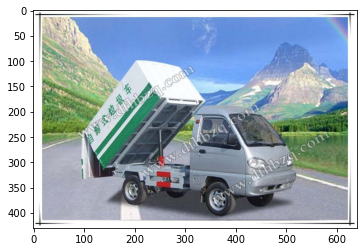

7808


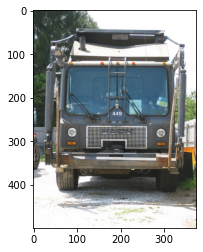

9344


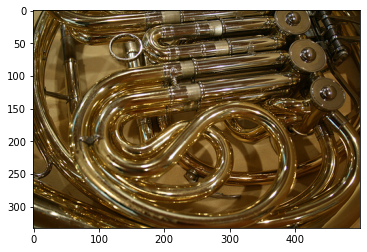

8448


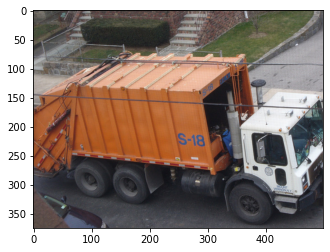

7744


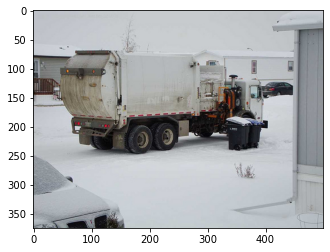

7936


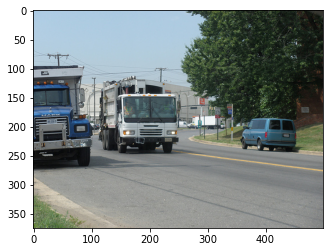

8256


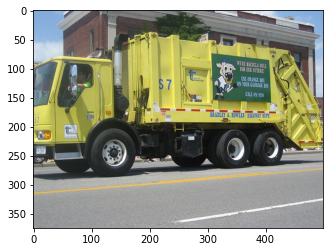

8128


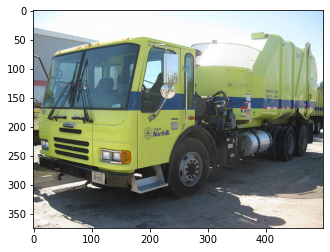

In [24]:
idx, xc = get_top_k(xq)

Again no positives, we need to repeat this process a few times...

  0%|          | 0/30 [00:00<?, ?it/s]

2816


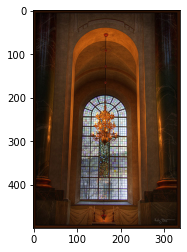

3648


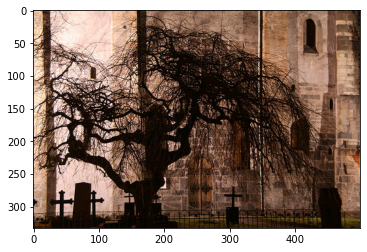

3264


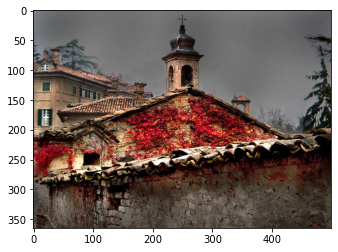

3520


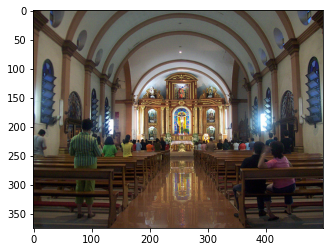

3008


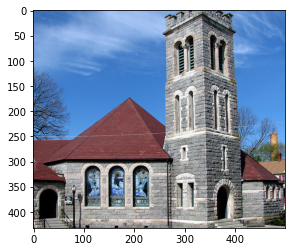

3392


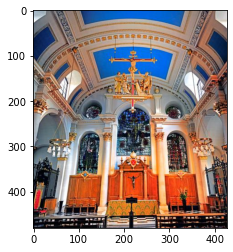

6208


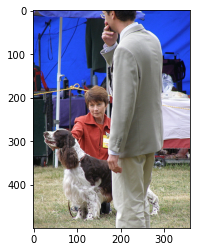

2944


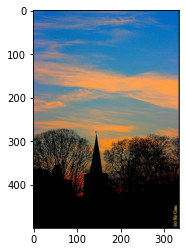

3200


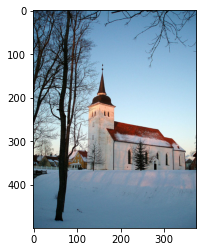

6400


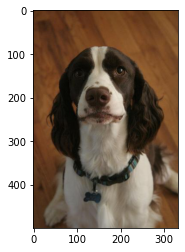

In [25]:
positives = []
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

We now have our first dog images, so we add the `idx` values of these images to the `positives` list and repeat the training process.

  0%|          | 0/30 [00:00<?, ?it/s]

5696


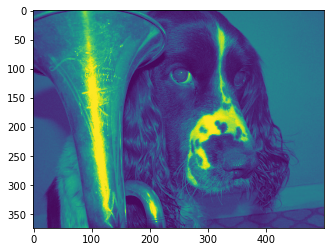

5952


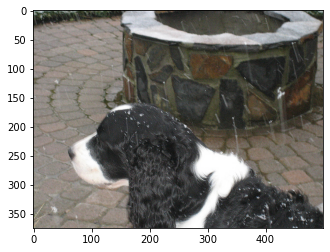

5760


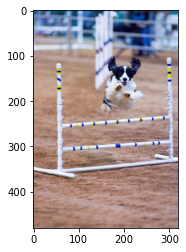

6464


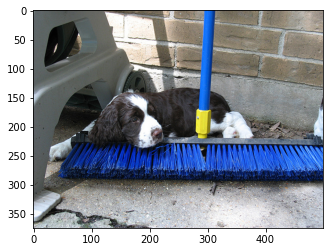

6272


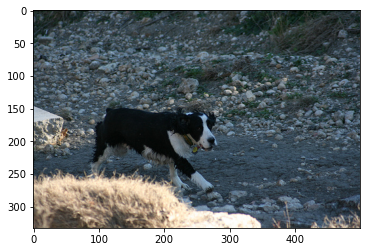

5888


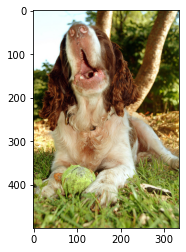

6080


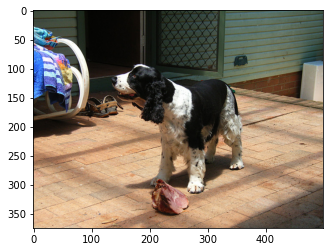

5824


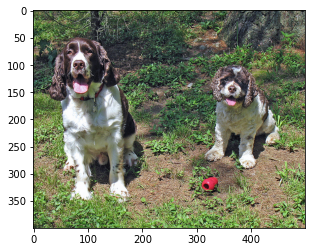

6016


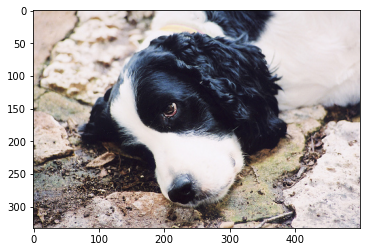

6528


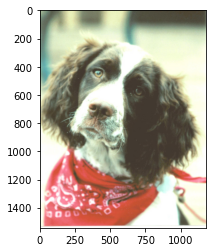

In [26]:
positives = [6208, 6400]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

As we're performing multiple training steps with a relatively high learning rate (`lr`), the model is pretty responsive and moves quickly in the direction of more dogs as we can see. We add these to our `positives` list.

  0%|          | 0/30 [00:00<?, ?it/s]

6336


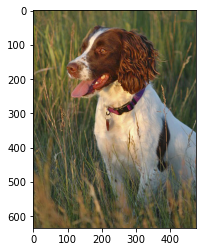

6144


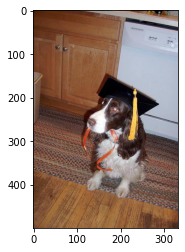

5632


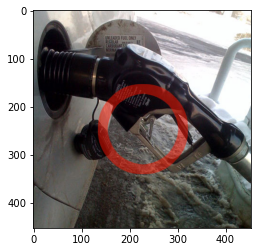

6592


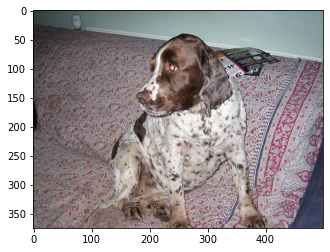

1408


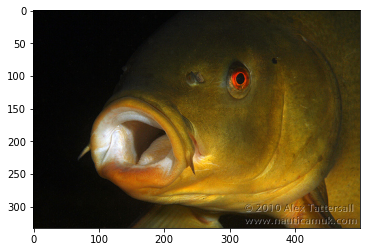

1856


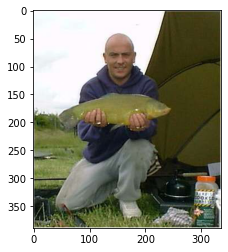

1728


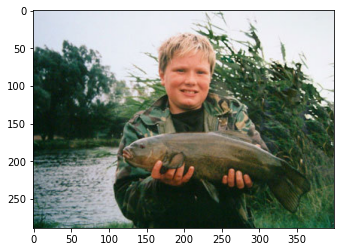

1024


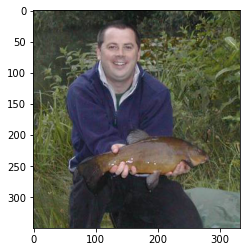

1088


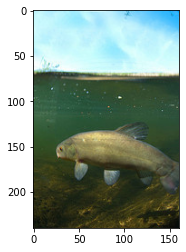

1152


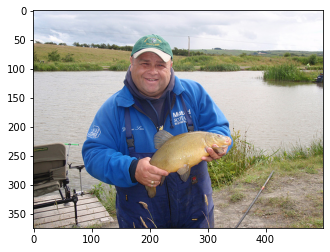

In [27]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

  0%|          | 0/30 [00:00<?, ?it/s]

7232


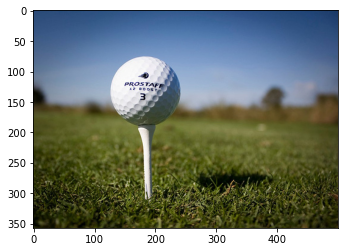

7360


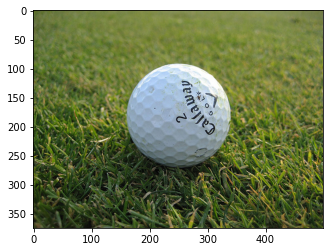

6976


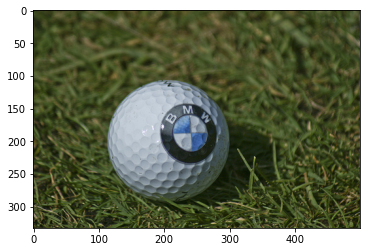

7296


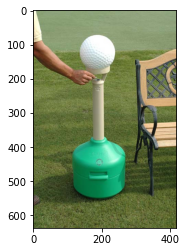

7040


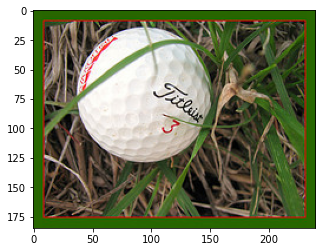

7168


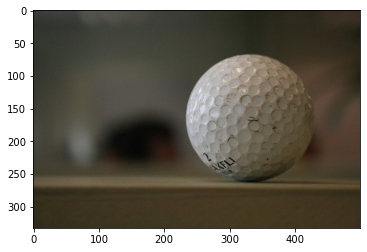

7424


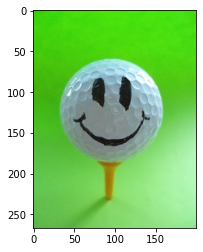

6784


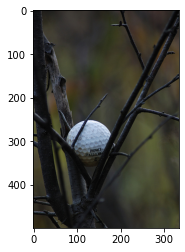

6656


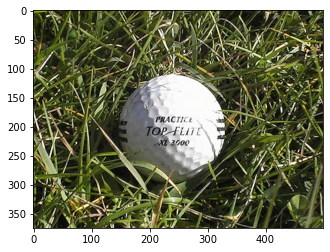

6848


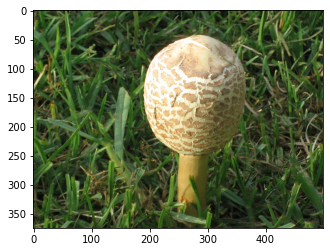

In [28]:
positives = [6336, 6144, 6592]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Here it seems like the grass from image `6336` (dog sitting in grass) pushed the model weights towards a vector space full of "objects in grass". Unfortunately not the objects we want, so these are negatives.

  0%|          | 0/30 [00:00<?, ?it/s]

6023


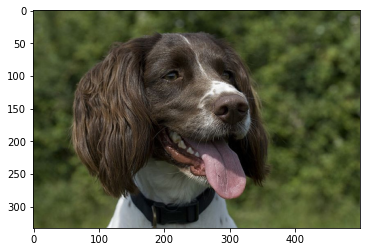

5825


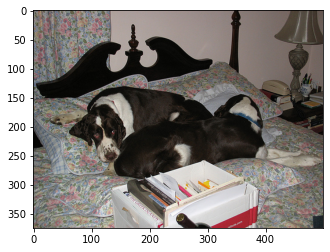

6123


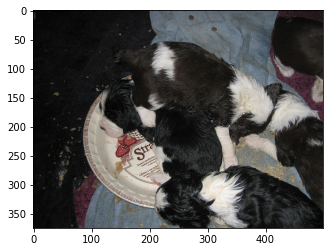

6024


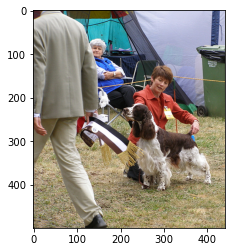

5745


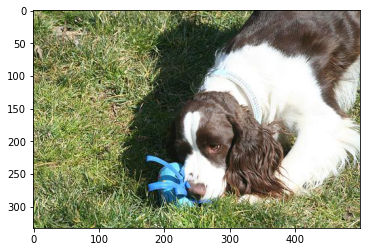

6209


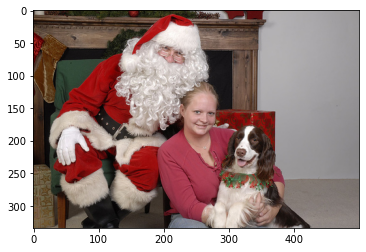

5995


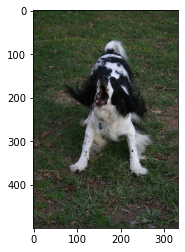

6216


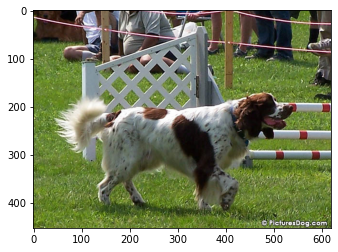

6065


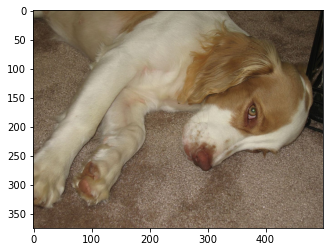

6443


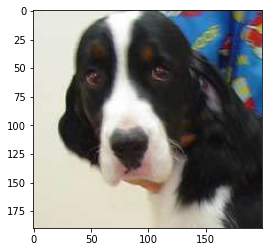

In [29]:
positives = []
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Those negatives seem to have helped our model out a lot, pushing it back toward dog territory.

  0%|          | 0/30 [00:00<?, ?it/s]

5831


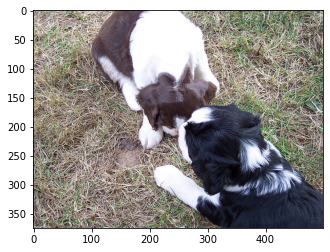

6465


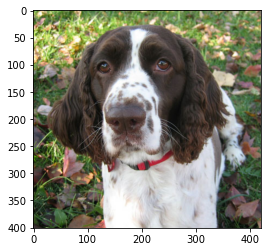

5703


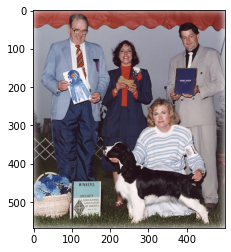

6017


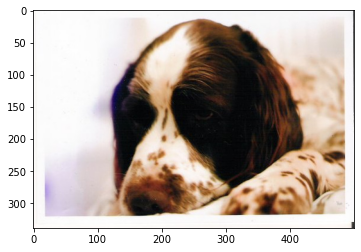

5761


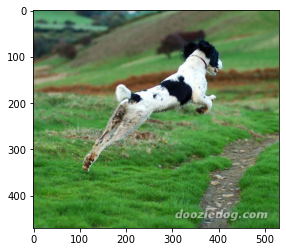

5889


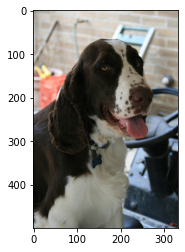

5697


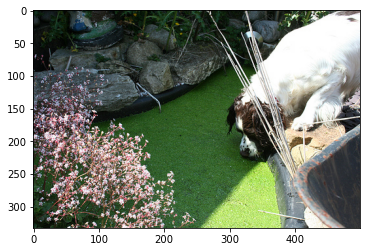

6187


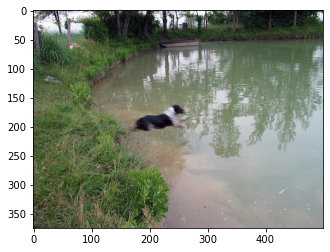

6401


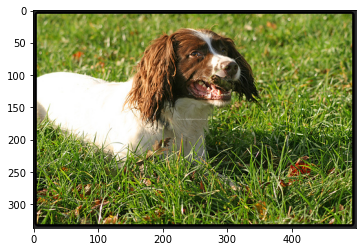

5953


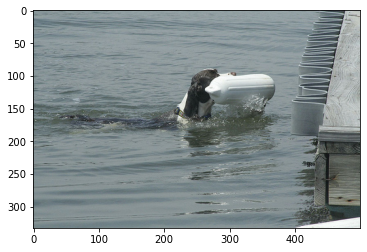

In [30]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Our model is getting pretty good at producing dog queries already, and we can keep going; it will become better tuned to identifying dogs.

  0%|          | 0/30 [00:00<?, ?it/s]

5633


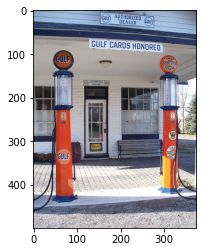

6215


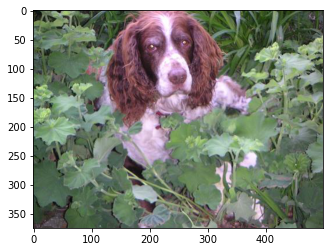

6471


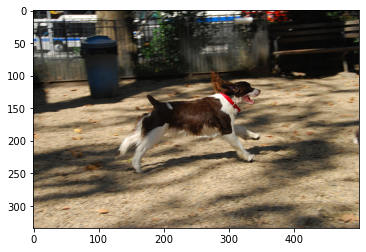

5639


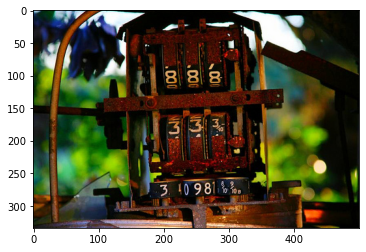

6273


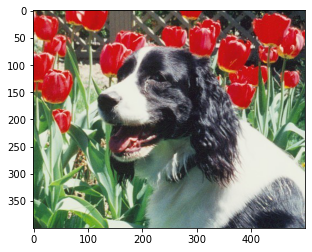

6407


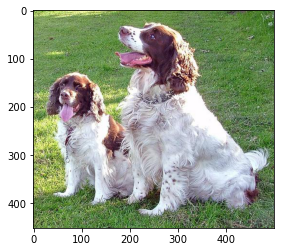

6279


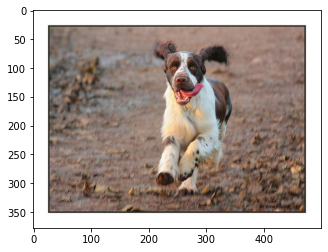

6529


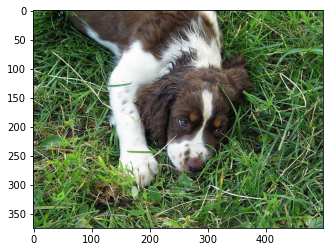

6251


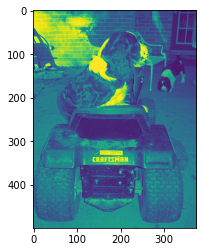

6081


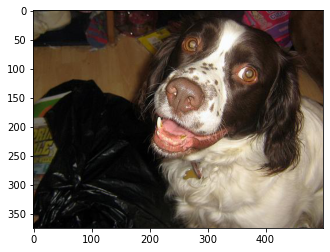

In [31]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

A few negative examples, this is great for training.

  0%|          | 0/30 [00:00<?, ?it/s]

5867


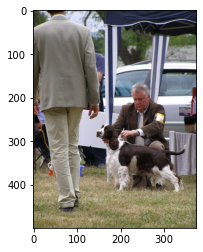

6577


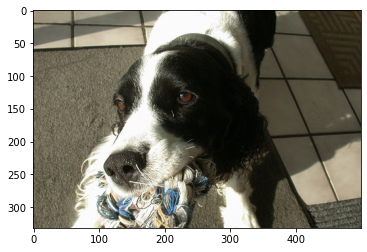

6449


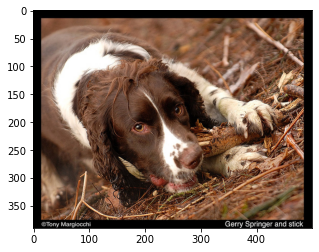

5809


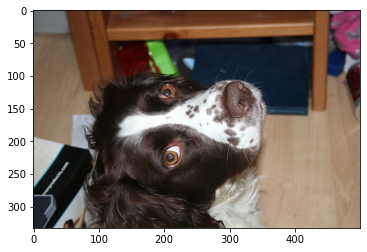

5739


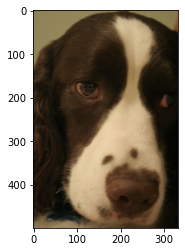

6315


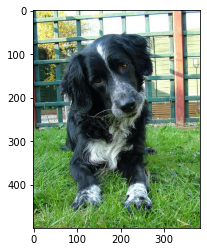

5681


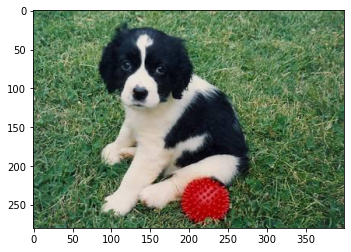

5996


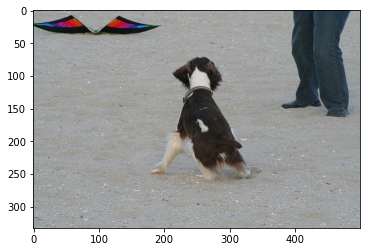

5937


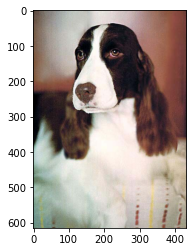

5803


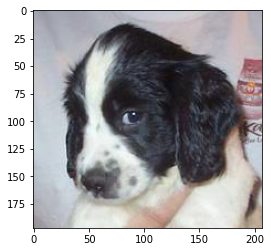

In [32]:
positives = [6215, 6471, 6273, 6407, 6279, 6529, 6251, 6081]
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Over time the number of negative samples coming through our queries will become fewer.

  0%|          | 0/30 [00:00<?, ?it/s]

6513


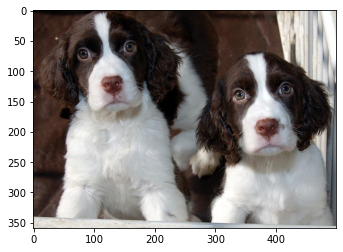

6571


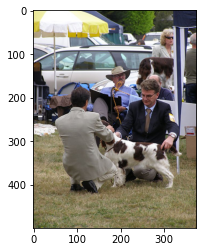

5931


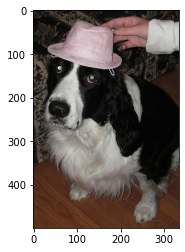

6001


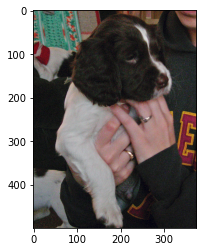

6448


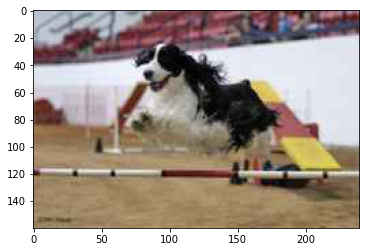

6129


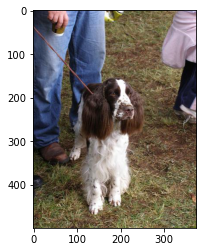

6379


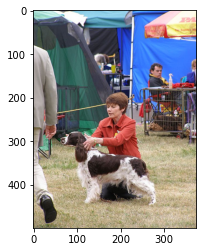

6059


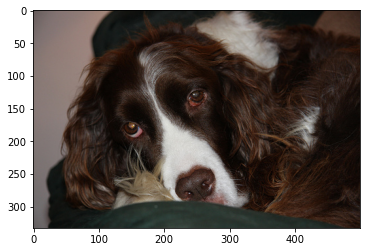

6257


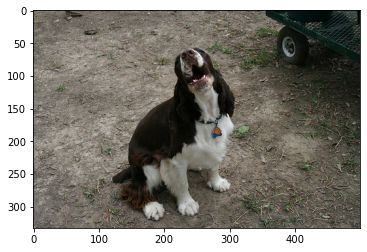

6385


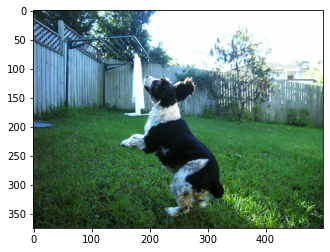

In [33]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

  0%|          | 0/30 [00:00<?, ?it/s]

6507


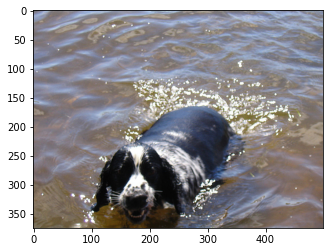

5873


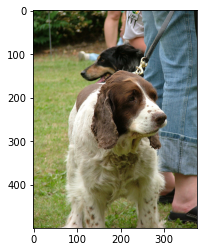

6193


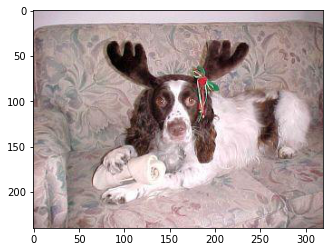

6321


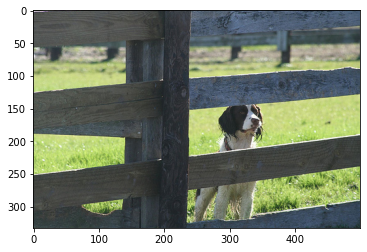

6564


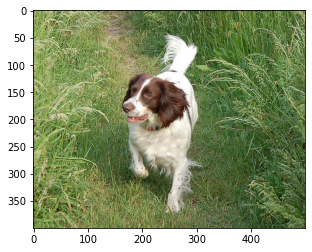

5866


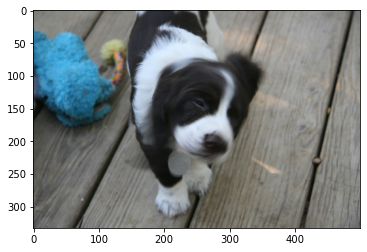

6116


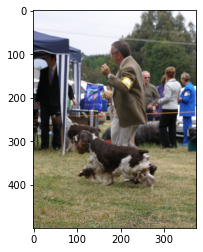

6122


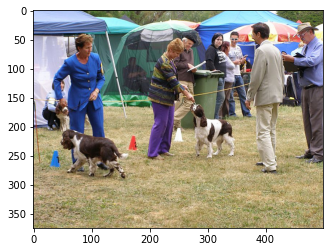

5674


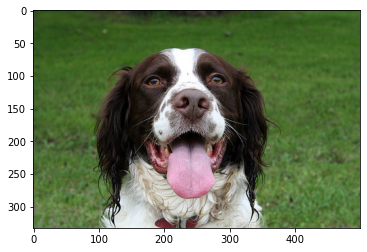

6576


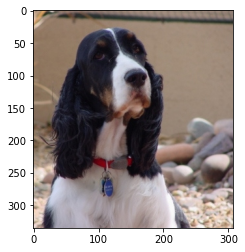

In [34]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

  0%|          | 0/30 [00:00<?, ?it/s]

5732


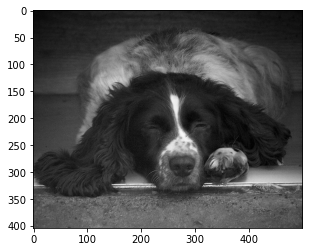

6447


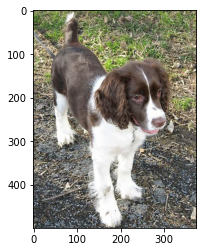

5895


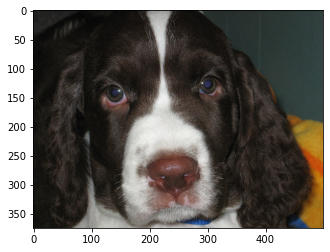

6252


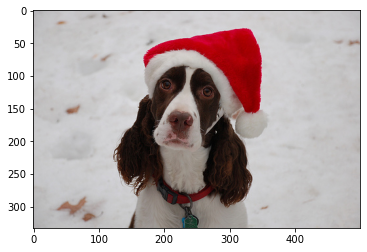

5808


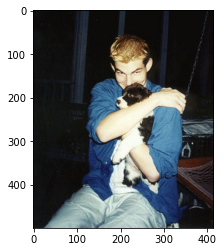

6535


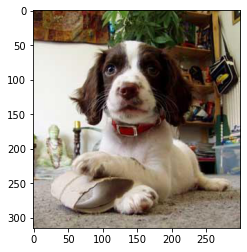

6244


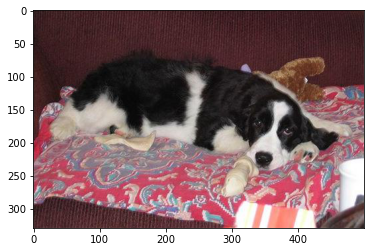

6151


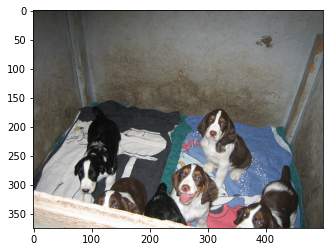

6286


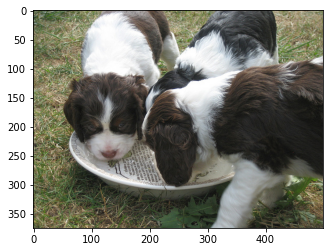

6145


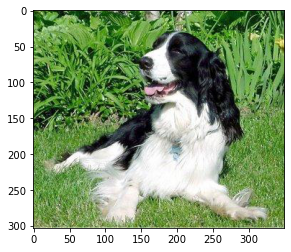

In [35]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

  0%|          | 0/30 [00:00<?, ?it/s]

6343


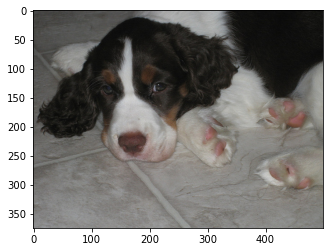

5767


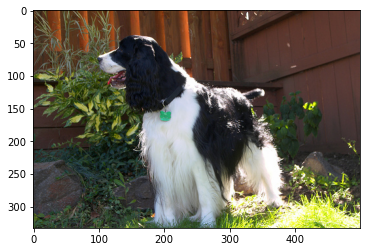

6536


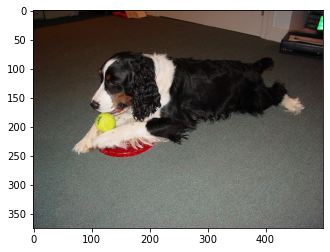

5738


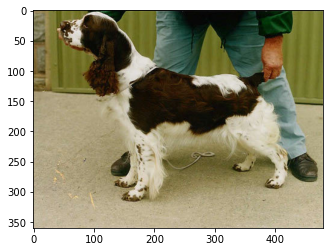

6442


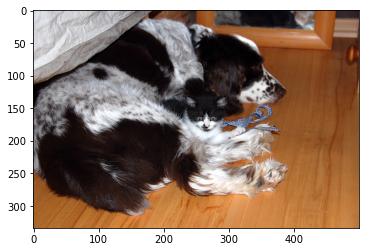

6506


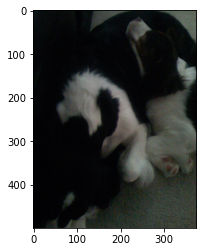

6500


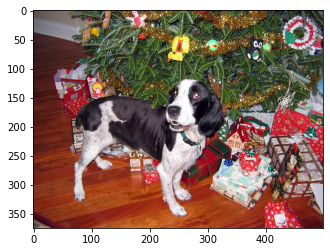

6180


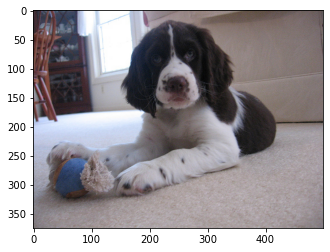

6087


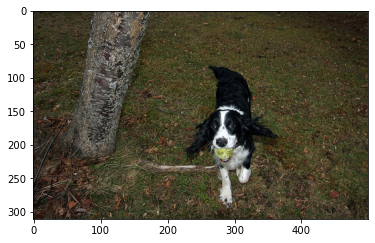

5959


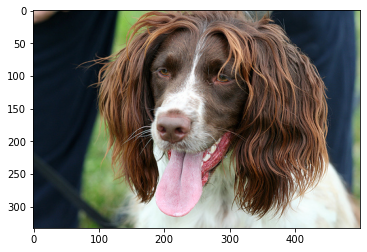

In [36]:
positives = idx
xq = tune(positives, xc, idx)
idx, xc = get_top_k(xq)

Okay, we get the point - we're returning a lot of dog pictures and our classifier is producing great queries for finding dogs. We can continue training like this for a long time, we could even modify our search to look specifically for *"dogs at dog shows"* or *"dogs on fields"*, etc.

But at some point, we will probably want to test the classifier query vector on an unfiltered dataset, or even refresh results for further fine-tuning (like a second training epoch). We can do this in one of two ways:

* We drop the `filter` argument, this would not work if needing to perform a second iteration of training over the same data.
* We reset the filter values, switching all records where `{"seen": 1}` back to `{"seen": 0}`.

We will go ahead and take the second approach:

In [39]:
while True:
    xc = index.query(xq, top_k=100, filter={"seen": 1})
    idx = [match['id'] for match in xc['matches']]
    if len(idx) == 0: break
    for i in idx:
        index.update(str(i), set_metadata={"seen": 0})

Now if we search again, we will return a completely unfiltered view of the search results.

5995


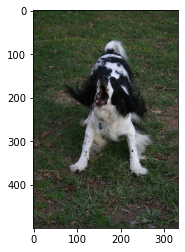

6187


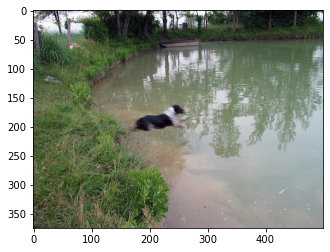

6443


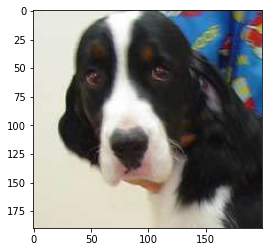

6251


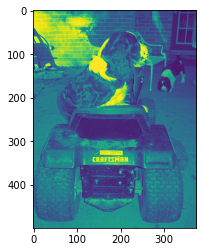

6123


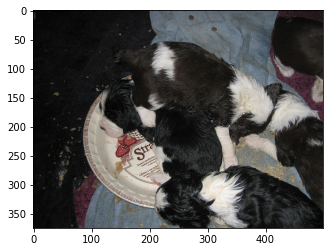

5867


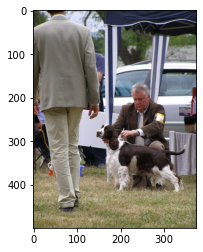

6577


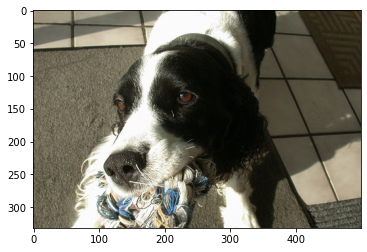

6065


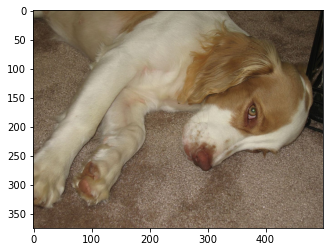

5809


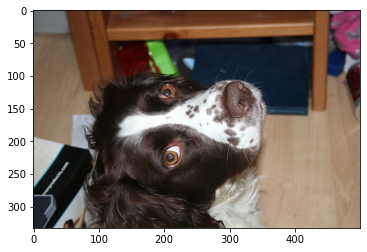

5745


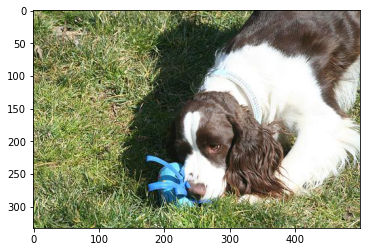

In [40]:
idx, xc = get_top_k(xq)

Plenty of dogs!

---

*Optional: save the record of queries and returned items for visualization with the `xx-visualize.ipynb` notebook.*

In [41]:
import numpy as np

with open('xq_list_torch.npy', 'wb') as f:
    np.save(f, np.array(xq_list))
with open('xc_list_torch.npy', 'wb') as f:
    np.save(f, np.array(xc_list))

/var/folders/g7/qd2j76kn64ggrl4ym2vlvzwr0000gn/T/ipykernel_87987/570168636.py:6: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  np.save(f, np.array(xc_list))


---